In [1]:
import os
import sys
module_path = os.path.abspath(os.path.join('../src/'))
if module_path not in sys.path:
    sys.path.append(module_path)

os.chdir("../")
print("Current working directory:", os.getcwd())

Current working directory: /home/ec2-user/workspace/loce


## GMM-UMAP subconcepts

/home/ec2-user/workspace/venvs/gcpv_venv_no_gpu/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


2025-01-29 16:57:39.154 INFO loce_clusterer.py.loce_dendogram:761 Plotting dendogram...



EfficientNet.features.7.0.car.euclidean


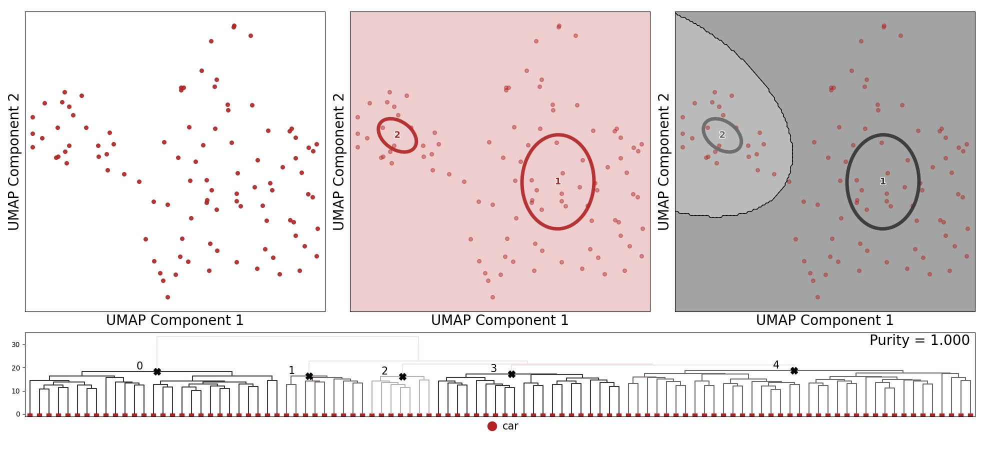

In [2]:
%matplotlib inline

from PIL import Image

from loce import LoCEDimensionReducer, LoCEMultilayerStorageDirectoryLoader

in_dir = "./experiment_outputs/optimized_loces_coco/"
out_dir = "./experiment_outputs/subconcepts_coco/"
seed = 42
model_tag = "efficientnet"
segmentation_type = "original"
dataset = "coco"

method = "ward"
distance = "euclidean"

layer = "features.7.0"

category_set_name = "car"

n_samples_per_category = 100

category_id = 3  # car

category_sets = {
        category_set_name: [category_id],
    }

# linkage clustering parameters, for finer structure
hac_clustering_type = 'linkage'
hac_clustering_kwargs = {"cluster_linkage_threshold": 20}

loce_dir = os.path.join(in_dir, f"loce_{segmentation_type}_{model_tag}")
loce_loader = LoCEMultilayerStorageDirectoryLoader(loce_dir, seed=seed)

loce_reducer = LoCEDimensionReducer(out_dir_base=out_dir, method_distance=[(method, distance)], seed=seed, n_samples_per_tag=n_samples_per_category)
# override category sets for clarity, the same as in the original experiment
loce_reducer.category_sets = category_sets
loce_reducer.evaluate_one_single_plot(loce_loader, model_tag, [layer], dataset_tag=dataset, hac_clustering_type=hac_clustering_type, hac_clustering_kwargs=hac_clustering_kwargs)


# Display the image (PDF file is also saved in the same folder)
folder_name = f"{layer}_{method}_{distance}"
file_name = f"umap_{model_tag}_{layer}_{category_set_name}_{distance}_one_plot.jpg"

image = Image.open(os.path.join(out_dir, model_tag, category_set_name, folder_name, file_name))
image.show()

## GMM-UMAP subconcepts: content

car GMM component 1


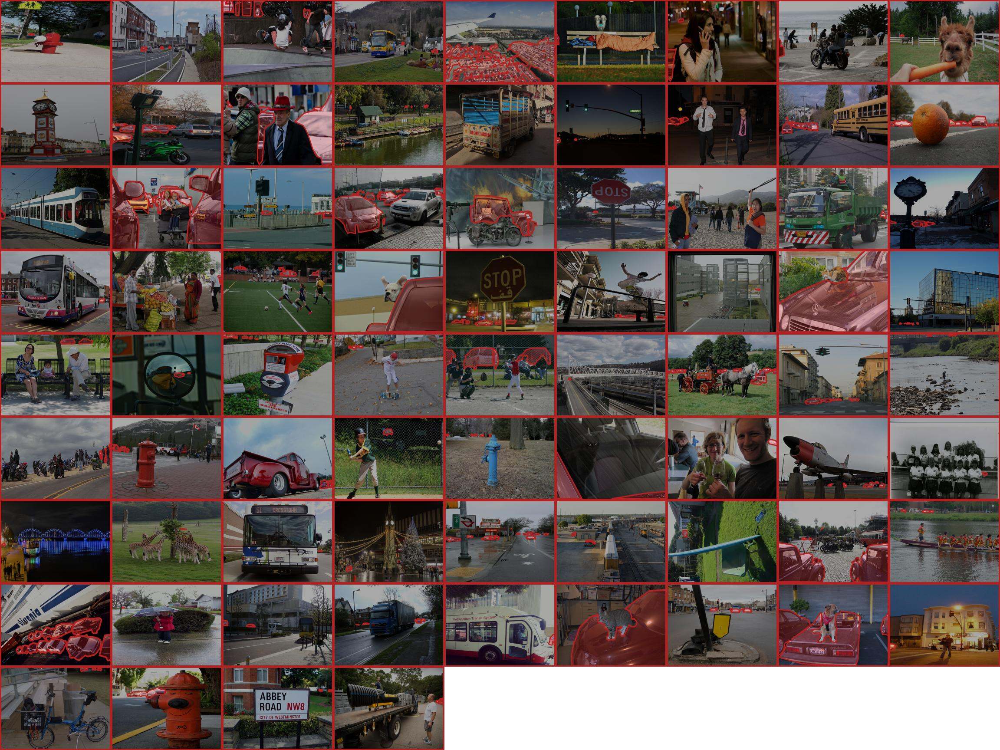

car GMM component 2


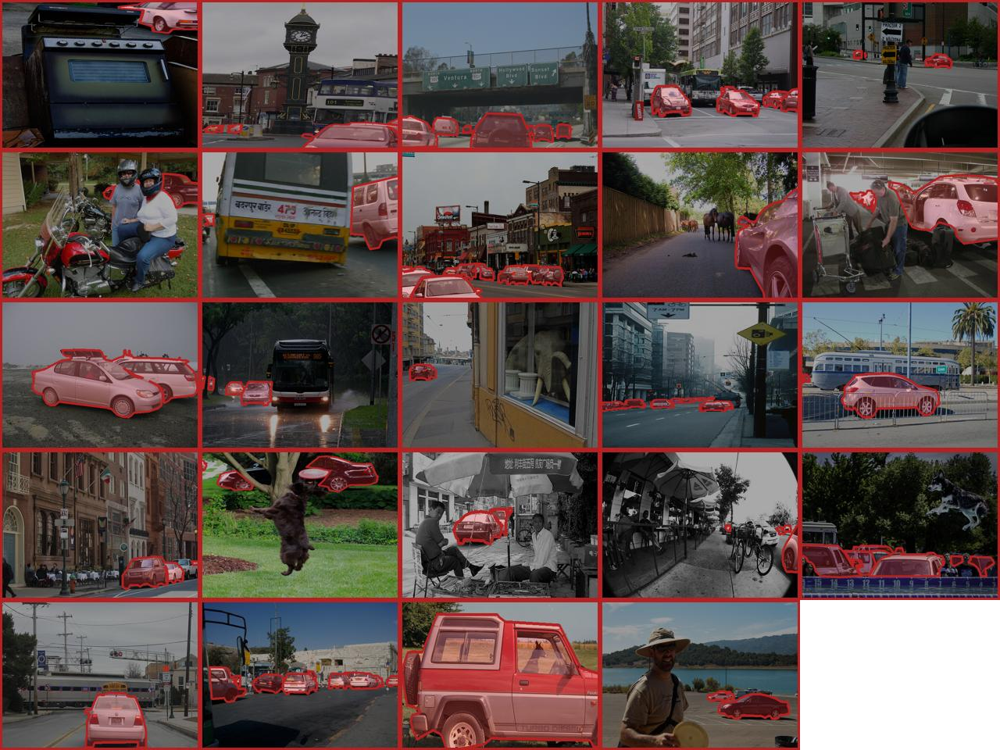

In [3]:
from loce import MSCOCO_CATEGORIES

# show content of GMM components (top middle)
gmm_ids = [1, 2]

for gmm_id in gmm_ids:
    print(MSCOCO_CATEGORIES[category_id], "GMM component", gmm_id)
    # (top middle) results
    image = Image.open(os.path.join(out_dir, model_tag, category_set_name, folder_name, "loce_umap_gmm_imgs_tiles", f"category_{category_id}_gmm_{gmm_id}.jpg"))
    # (top right) results, absolutely the same  
    # image = Image.open(os.path.join(out_dir, model_tag, category_set_name, folder_name, "loce_umap_gmm_imgs_tiles_ignored_labels", f"category_-1_gmm_{gmm_id}.jpg"))
    image.show()

## Hierarchial Clustering subconcepts

In [4]:
from loce import LoCEClusterer, draw_mscoco_categories_and_colors, draw_voc_categories_and_colors

# recalculate dendrogram shown above
if dataset == "voc":
    selected_tag_id_names, selected_tag_ids_and_colors = draw_voc_categories_and_colors([category_id])
else:
    selected_tag_id_names, selected_tag_ids_and_colors = draw_mscoco_categories_and_colors([category_id])

loce_loader = LoCEMultilayerStorageDirectoryLoader(loce_dir, seed=seed)
loce_storages = loce_loader.load([category_id])

loce_clusterer = LoCEClusterer(selected_tag_ids_and_colors, selected_tag_id_names, [layer], n_samples_per_category, distance_metric=distance, clustering_method=method, save_dir=out_dir, **hac_clustering_kwargs)
_ = loce_clusterer.cluster_loces(loce_storages, clustering_type=hac_clustering_type, save_proj=False)

2025-01-29 16:57:59.327 INFO loce_clusterer.py._estimate_clustering_state:204 Clustering layers: features.7.0, Purity: 1.000, Number of clusters: 5


## Hierarchial Clustering subconcepts: content

car Cluster 0


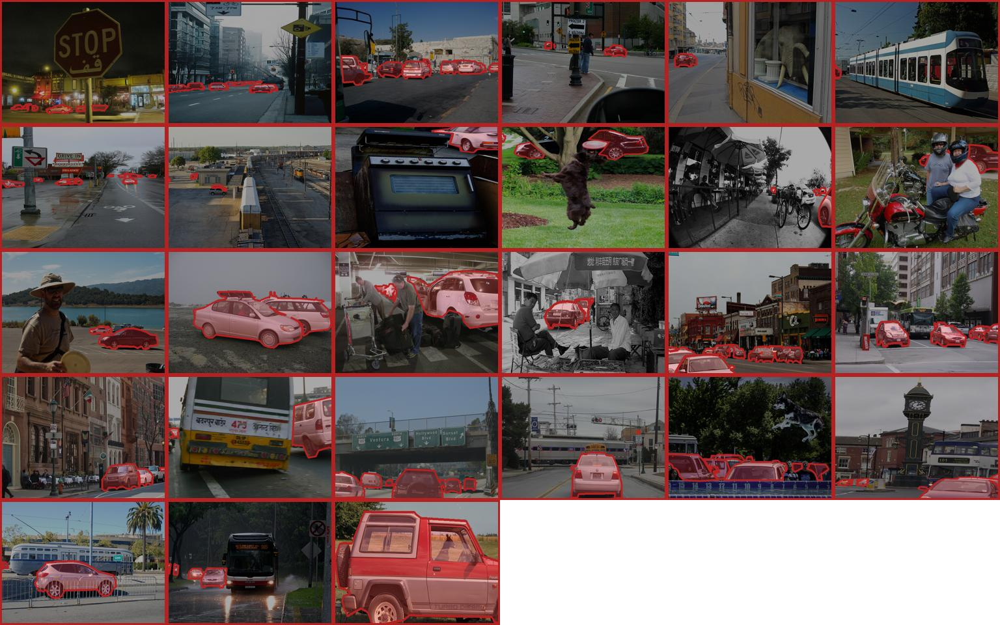

car Cluster 1


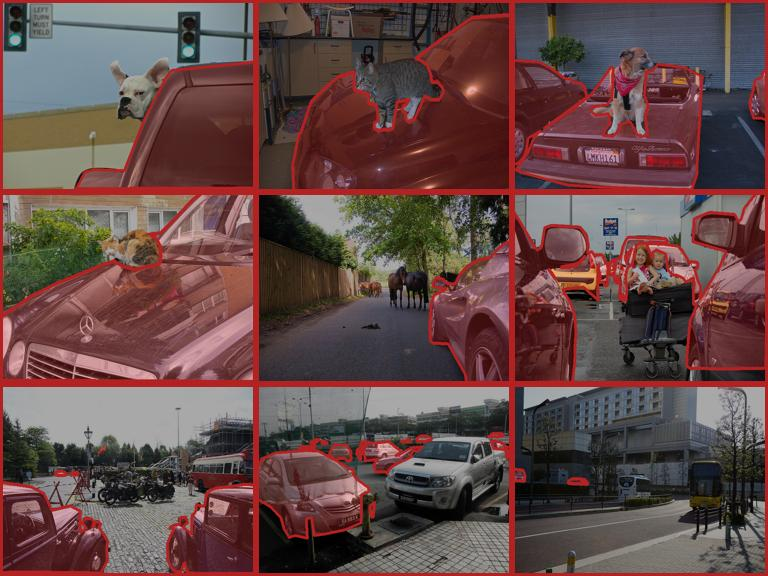

car Cluster 2


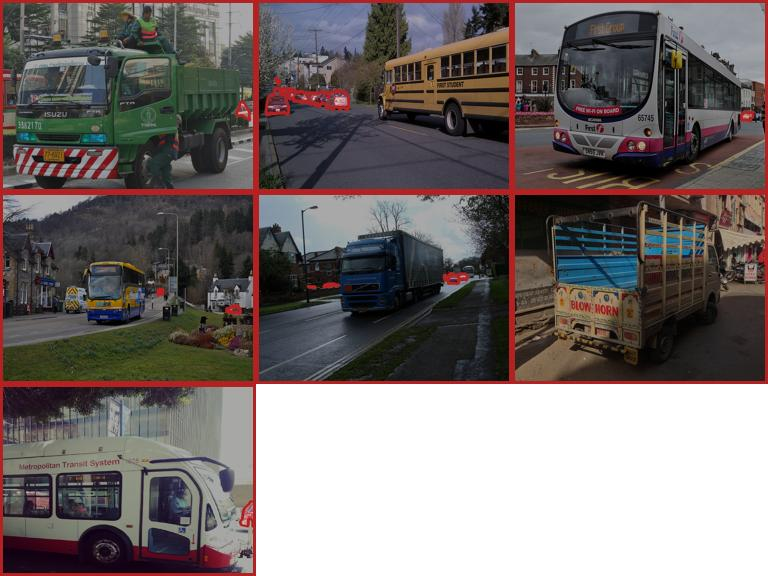

car Cluster 3


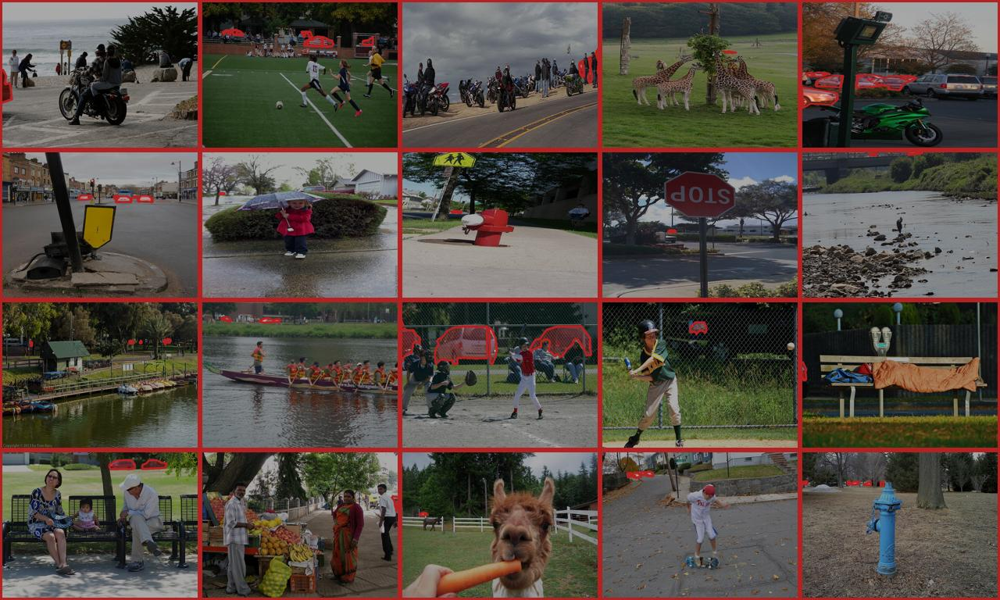

car Cluster 4


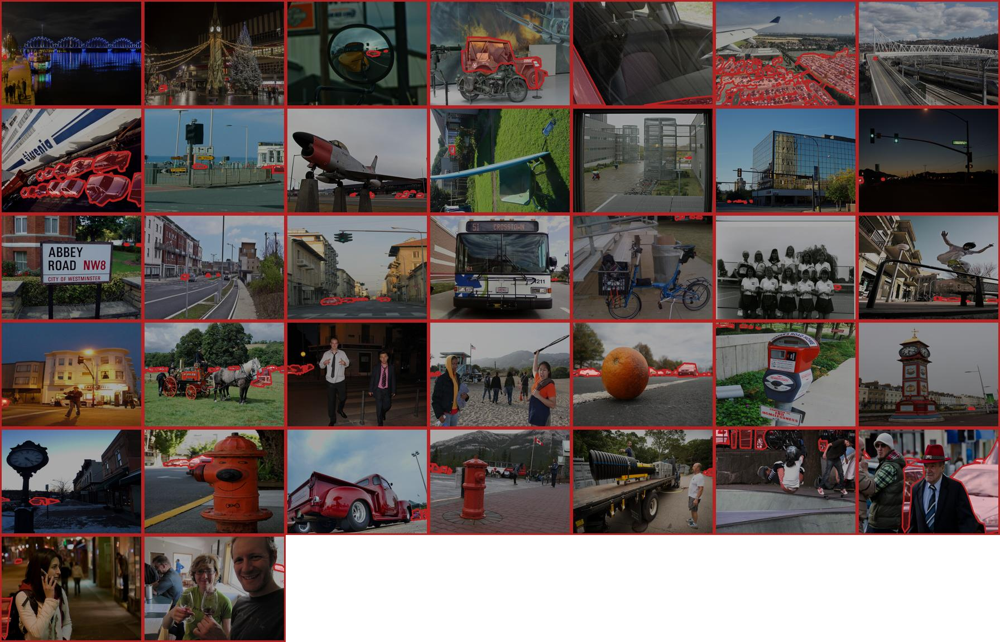

In [5]:
# show content of clusters
n_clusters = len(loce_clusterer.cluster_infos)

for cluster_id in range(n_clusters):
    print(MSCOCO_CATEGORIES[category_id], "Cluster", cluster_id)
    # (top middle) results
    image = Image.open(os.path.join(out_dir, "loce_clustered_imgs_tiles", f"cluster_{cluster_id}.jpg"))
    image.show()

## Hierarchial Clustering subconcepts: sub-global concept projections

In [6]:
from loce import LoCEActivationsTensorExtractor
from loce import yolo5_propagator_builder, mobilenet_propagator_builder, efficientnet_propagator_builder
from loce import detr_propagator_builder, vit_propagator_builder, swin_propagator_builder  

imgs_path = f"./data/mscoco2017val/val2017/"

image_names = [
    "000000336232.jpg",
    "000000369812.jpg",
    "000000458325.jpg",
    "000000542625.jpg",
    "000000577932.jpg"
    ]

prop_builders = {
        "detr": detr_propagator_builder,
        "vit": vit_propagator_builder,
        "swin": swin_propagator_builder,
        "efficientnet": efficientnet_propagator_builder,
        "mobilenet": mobilenet_propagator_builder,
        "yolo": yolo5_propagator_builder,
    }

if model_tag == 'detr':
    prop, processor = prop_builders[model_tag]()
else:
    prop = prop_builders[model_tag]()
    processor = None

for img_name in image_names:
    act_gen = LoCEActivationsTensorExtractor(prop, model_tag, processor=processor)
    loce_clusterer.loce_cluster_projection(act_gen, imgs_path, img_name)

2025-01-29 16:58:02.602 INFO loce_clusterer.py.loce_cluster_projection:937 Evaluating cluster projections...
2025-01-29 16:58:04.148 INFO loce_clusterer.py.loce_cluster_projection:937 Evaluating cluster projections...
2025-01-29 16:58:04.762 INFO loce_clusterer.py.loce_cluster_projection:937 Evaluating cluster projections...
2025-01-29 16:58:05.390 INFO loce_clusterer.py.loce_cluster_projection:937 Evaluating cluster projections...
2025-01-29 16:58:06.50 INFO loce_clusterer.py.loce_cluster_projection:937 Evaluating cluster projections...


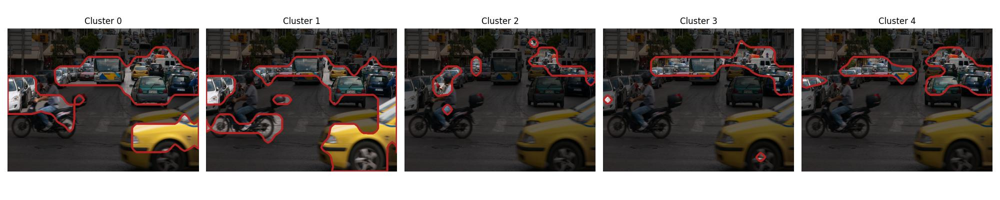

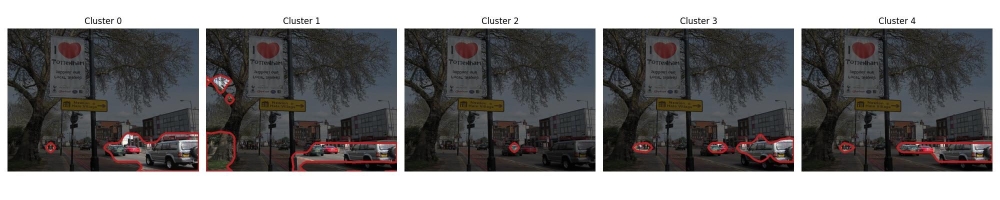

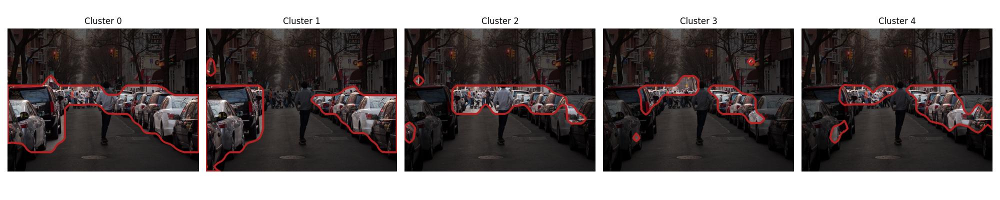

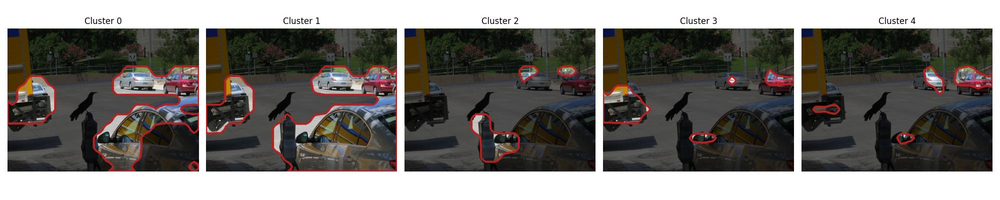

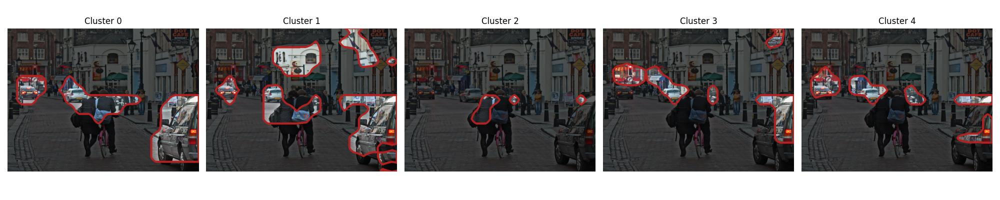

In [7]:
for img in image_names:
    image = Image.open(os.path.join(out_dir, f"projections_{img}.jpg"))
    image.show()